In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import harmonypy as hm
import anndata
import os
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
from scipy import io
import scvelo as scv

sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')

# set random seed for reproducibility:
np.random.seed(42)


In [2]:
# set working dir 
os.chdir('/dfs3b/swaruplab/shared_lab/cross-disorder/analysis/individual/Zhou_2020')

fig_dir = 'figures/'
data_dir = 'data/'


In [3]:
# re-load processed data:
adata = sc.read_h5ad('{}/Zhou_2020_processed.h5ad'.format(data_dir))


## Load Zhou et al 2020 AD dataset:

In [14]:
count_data_dir = '/dfs3b/swaruplab/shared_lab/cross-disorder/count_matrices/AD_Zhou_2020/'
samples = [s for s in os.listdir(count_data_dir)]
adata_list = []
for sample in samples:
    try:
        adata = sc.read_h5ad('{}{}/scanpy_preprocessing_cellbender/data/adata_unfiltered.h5ad'.format(count_data_dir, sample))
    except:
        print('sample', sample, ' error')
        continue
    adata.obs['Sample'] = sample
    adata.obs['Study'] = 'Zhou_2020'
    adata.obs['orig_barcode'] = adata.obs.index

    adata_list.append(adata)

    print(sample, adata.layers['spliced'].shape)


AD1 (1884, 36601)
AD10 (5161, 36601)
AD11 (4575, 36601)
AD12 (6532, 36601)
AD13 (5455, 36601)
AD2 (3487, 36601)
AD3 (4640, 36601)
AD5 (5229, 36601)
AD7 (8741, 36601)
AD8 (2610, 36601)
AD9 (3599, 36601)
C1 (3458, 36601)
C11 (5247, 36601)
C12 (5002, 36601)
C2 (4485, 36601)
C3 (7486, 36601)
C4 (3139, 36601)
C5 (9188, 36601)
C6 (6884, 36601)
C7 (9181, 36601)
C8 (9360, 36601)
C9 (5946, 36601)
P10 (5055, 36601)
P11 (5873, 36601)
P12 (6188, 36601)
P13 (4430, 36601)
P2 (4176, 36601)
P3 (4771, 36601)
P5 (5696, 36601)
P6 (5128, 36601)
P7 (5733, 36601)
P9 (7575, 36601)


In [15]:
# concatenate
adata = adata_list[0].concatenate(adata_list[1:])
adata.obs['barcode'] = adata.obs.index

# filter small cells
sc.pp.filter_cells(adata, min_counts = 250)

# add counts layer
adata.layers["counts"] = adata.X.copy()

# print shape of dataset
adata.shape


(168080, 36601)

In [16]:
adata

AnnData object with n_obs × n_vars = 168080 × 36601
    obs: 'orig_barcode', 'n_counts', 'doublet_scores', 'doublets', 'Sample', 'Study', 'batch', 'barcode'
    var: 'gene_ids'
    layers: 'spliced', 'unspliced', 'counts'

In [19]:
# load two meta tables:
rosmap_meta = pd.read_csv(
    '/dfs3b/swaruplab/shared_lab/cross-disorder/meta_data/AD_Zhou_2020/ROSMAP_clinical.csv',
    sep = ','
)

# load biospecimen table
sample_meta = pd.read_csv(
    '/dfs3b/swaruplab/shared_lab/cross-disorder/meta_data/AD_Zhou_2020/snRNAseqAD_TREM2_biospecimen_metadata.csv',
    sep=','
)

# merge information from both tables:
sample_meta= sample_meta.merge(
    rosmap_meta,
    how='left', 
    on = 'individualID'
)
# group column 
sample_meta['group'] = [''.join([i for i in x if not i.isdigit()]) for x in sample_meta.specimenID]


# only keep select columns
cols = ['individualID', 'specimenID', 'group', 'msex', 'apoe_genotype', 'age_death', 'pmi', 'braaksc', 'ceradsc', 'cogdx']
sample_meta = sample_meta[cols]

In [20]:
temp = adata.obs.merge(
    sample_meta,
    how='left',
    left_on = 'Sample',
    right_on = 'specimenID'
)
temp.index = temp.barcode
adata.obs = temp
adata.obs.index.name = None

In [21]:
adata.obs.head()

,orig_barcode,n_counts,doublet_scores,doublets,Sample,Study,batch,barcode,individualID,specimenID,group,msex,apoe_genotype,age_death,pmi,braaksc,ceradsc,cogdx
ACGGGCTGTTGAGTTC-0,ACGGGCTGTTGAGTTC,53987.0,0.205882,Singlet,AD1,Zhou_2020,0,ACGGGCTGTTGAGTTC-0,R6528749,AD1,AD,0.0,33.0,86.113620807665981,21.0,3.0,1.0,4.0
GTGCTTCAGTGCCATT-0,GTGCTTCAGTGCCATT,51808.0,0.243697,Singlet,AD1,Zhou_2020,0,GTGCTTCAGTGCCATT-0,R6528749,AD1,AD,0.0,33.0,86.113620807665981,21.0,3.0,1.0,4.0
TCTGAGAGTAATCACC-0,TCTGAGAGTAATCACC,43235.0,0.294118,Singlet,AD1,Zhou_2020,0,TCTGAGAGTAATCACC-0,R6528749,AD1,AD,0.0,33.0,86.113620807665981,21.0,3.0,1.0,4.0
ACACCCTAGGCATGTG-0,ACACCCTAGGCATGTG,39937.0,0.294118,Singlet,AD1,Zhou_2020,0,ACACCCTAGGCATGTG-0,R6528749,AD1,AD,0.0,33.0,86.113620807665981,21.0,3.0,1.0,4.0
ACCCACTTCAACACCA-0,ACCCACTTCAACACCA,39609.0,0.190311,Singlet,AD1,Zhou_2020,0,ACCCACTTCAACACCA-0,R6528749,AD1,AD,0.0,33.0,86.113620807665981,21.0,3.0,1.0,4.0


In [22]:
# save unfiltered dataset:
adata.write_h5ad('{}Zhou_2020_unfiltered.h5ad'.format(data_dir))


... storing 'orig_barcode' as categorical
... storing 'doublets' as categorical
... storing 'Sample' as categorical
... storing 'Study' as categorical
... storing 'individualID' as categorical
... storing 'specimenID' as categorical
... storing 'group' as categorical
... storing 'age_death' as categorical


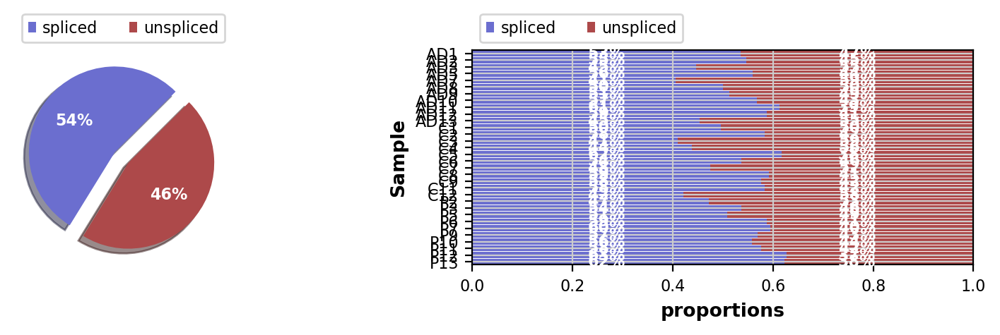

In [23]:
scv.pl.proportions(adata, groupby='Sample')

## Filter cells

In [3]:
# load unfiltered data 
adata = sc.read_h5ad('{}Zhou_2020_unfiltered.h5ad'.format(data_dir))

In [4]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)

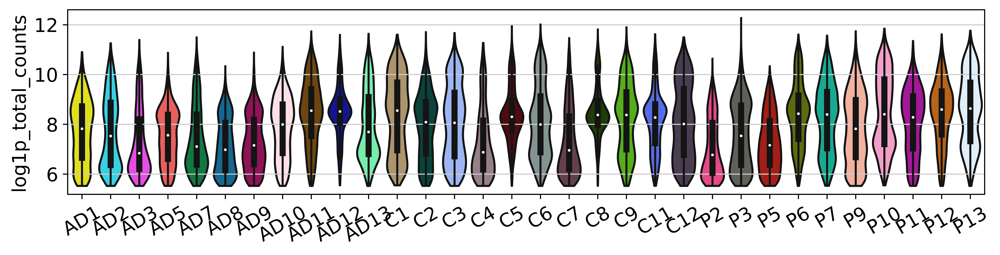

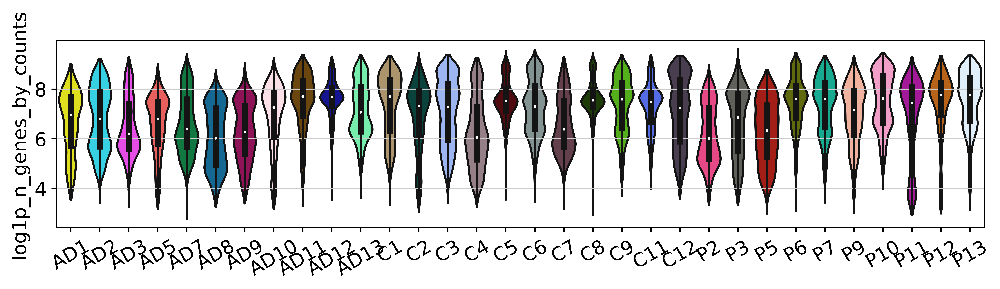

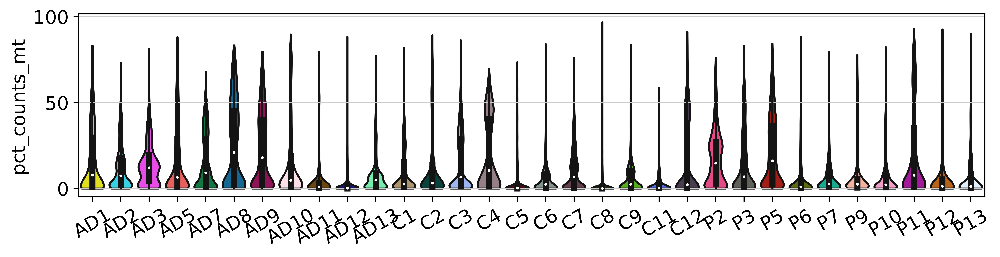

In [5]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)

In [6]:

mt_quantile = 0.975 
umi_quantile = 0.975
doublet_quantile = 0.95

samples = adata.obs.Sample.value_counts().index.to_list()
good_barcodes = []
for cur_sample in samples:
    
    # get just this sample
    cur_adata = adata[adata.obs.Sample == cur_sample]
    orig_cells = cur_adata.shape[0]
    
    # compute cutoffs for each sample
    mt_cutoff = cur_adata.obs.pct_counts_mt.quantile(mt_quantile)
    umi_cutoff = cur_adata.obs.total_counts.quantile(umi_quantile)
    doublet_cutoff = cur_adata.obs.doublet_scores.quantile(doublet_quantile)
    
    # subset the data based on thresholds
    cur_adata = cur_adata[(cur_adata.obs.pct_counts_mt < mt_cutoff) & (cur_adata.obs.total_counts < umi_cutoff) & (cur_adata.obs.doublet_scores < doublet_cutoff)]
    new_cells = cur_adata.shape[0]
    
    keep_cells = cur_adata.obs.barcode.to_list() 
    good_barcodes = good_barcodes + keep_cells
    print(cur_sample, 'removed ', orig_cells-new_cells, ', kept ', new_cells)

    

C8 removed  989 , kept  8356
C5 removed  949 , kept  8207
C7 removed  862 , kept  7504
AD7 removed  859 , kept  7464
C3 removed  739 , kept  6587
C6 removed  675 , kept  6160
AD12 removed  673 , kept  5849
P12 removed  619 , kept  5504
P9 removed  611 , kept  5464
C9 removed  586 , kept  5263
P11 removed  568 , kept  5105
P7 removed  561 , kept  5082
AD13 removed  562 , kept  4861
C11 removed  551 , kept  4659
P6 removed  512 , kept  4606
P5 removed  519 , kept  4537
P10 removed  534 , kept  4515
C12 removed  502 , kept  4485
AD10 removed  499 , kept  4404
AD5 removed  479 , kept  4348
AD11 removed  447 , kept  4103
P3 removed  483 , kept  4060
P13 removed  453 , kept  3969
AD3 removed  453 , kept  3957
C2 removed  434 , kept  3791
C1 removed  354 , kept  3096
AD2 removed  358 , kept  3085
AD9 removed  327 , kept  2897
P2 removed  326 , kept  2863
C4 removed  277 , kept  2477
AD8 removed  230 , kept  1994
AD1 removed  182 , kept  1655


In [7]:
# subset the full data by the good barcodes
adata = adata[adata.obs.index.isin(good_barcodes)]
adata.shape

(150907, 36601)

In [8]:
adata = adata[adata.obs.n_genes_by_counts >= 250]
adata = adata[adata.obs.pct_counts_mt <= 5]

adata.shape

(89368, 36601)

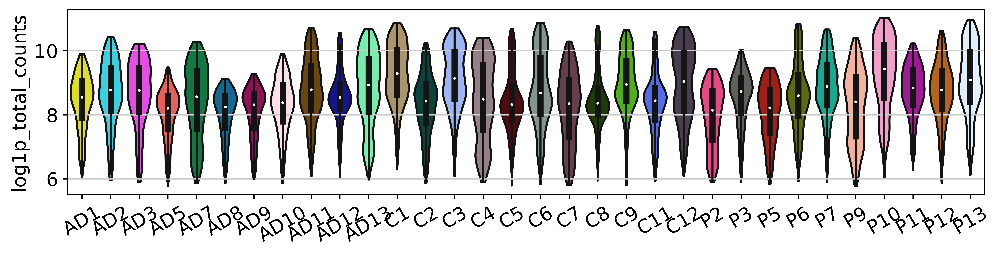

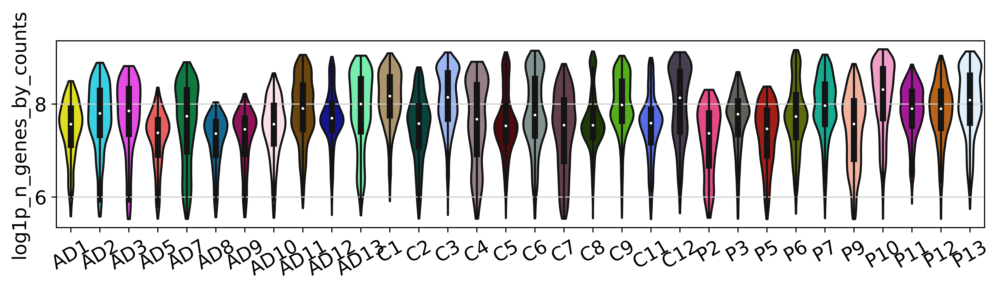

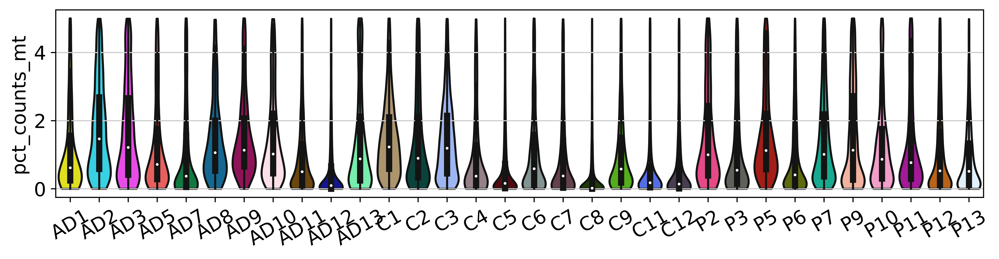

In [9]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)

## Process data:

In [10]:
# preserve the counts in its own layer
adata.layers['counts'] = adata.X

In [11]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

In [12]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'], n_jobs=16)
sc.pp.scale(adata, max_value=10)


In [13]:
sc.tl.pca(adata, svd_solver='arpack')

In [14]:
sc.external.pp.harmony_integrate(adata, key = 'Sample')

2022-03-04 11:41:22,209 - harmonypy - INFO - Iteration 1 of 10
2022-03-04 11:42:02,951 - harmonypy - INFO - Iteration 2 of 10
2022-03-04 11:42:43,696 - harmonypy - INFO - Iteration 3 of 10
2022-03-04 11:43:24,594 - harmonypy - INFO - Iteration 4 of 10
2022-03-04 11:44:05,677 - harmonypy - INFO - Iteration 5 of 10
2022-03-04 11:44:46,795 - harmonypy - INFO - Converged after 5 iterations


In [15]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=20, n_pcs=30, metric='cosine')

In [16]:
sc.tl.umap(adata, min_dist=0.35, method='umap')

In [17]:
sc.tl.leiden(adata, resolution=1.5)

#compute dendrogram for the dotplot:
sc.tl.dendrogram(adata, 'leiden')

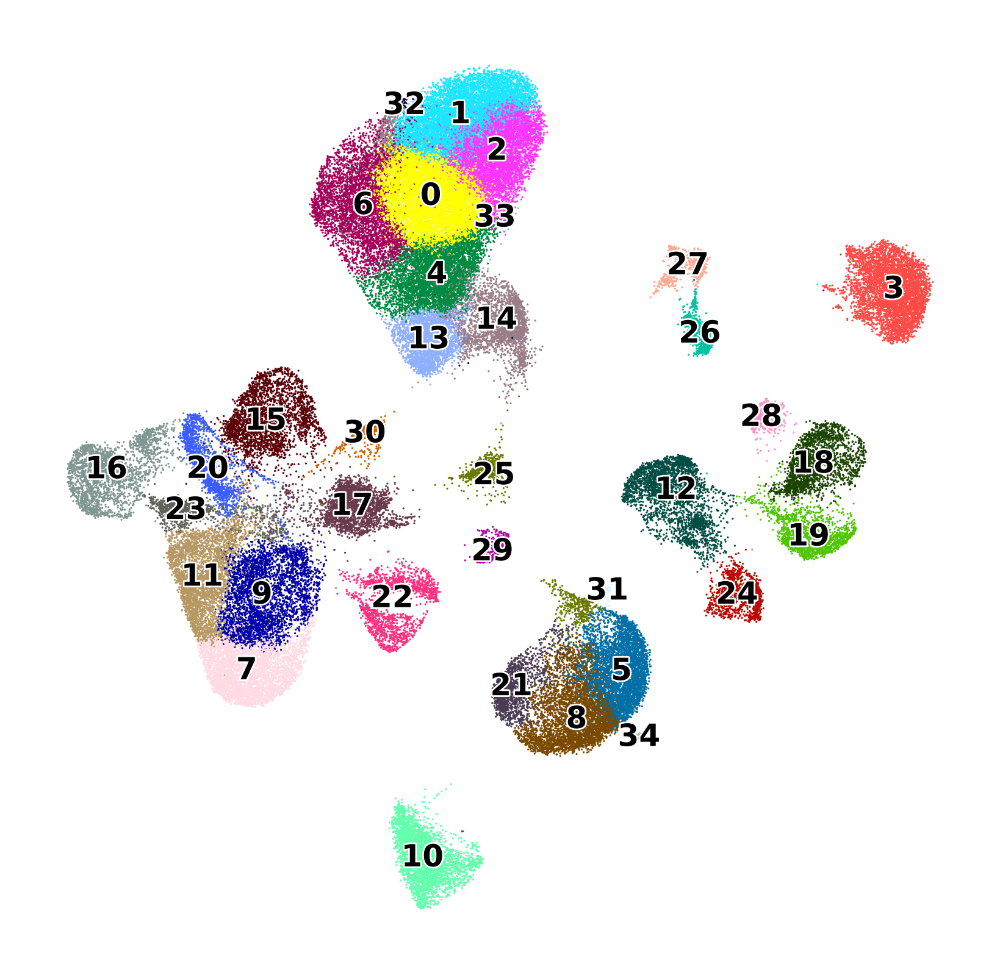

In [18]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['leiden'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    title='',
    save='_leiden.pdf'
)


categories: 0, 1, 2, etc.
var_group_labels: Oligodendrocyte, Astrocyte, Microglia, etc.


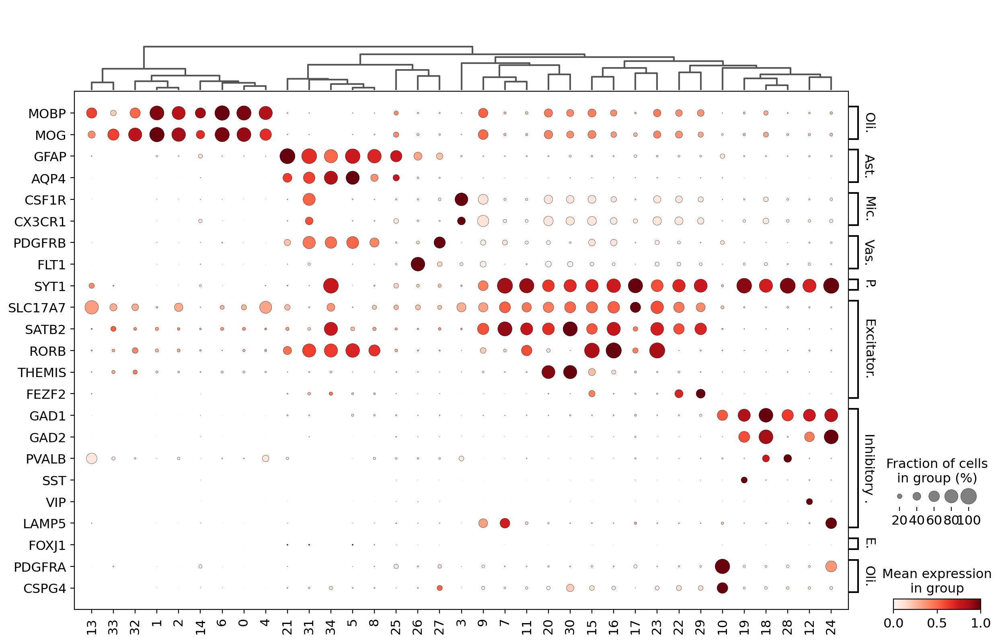

In [20]:
marker_dict = {
    'Oligodendrocyte': ['MOBP', 'MOG'],
    'Astrocyte': ['GFAP', 'AQP4'],
    'Microglia': ['CSF1R', 'CX3CR1',],
    'Vasculature': ['PDGFRB', 'FLT1'],
    'Pan-neuronal': ['SYT1'],
    'Excitatory Neuron': ['SLC17A7', 'SATB2', 'RORB', 'THEMIS', 'FEZF2'],
    'Inhibitory Neuron': ['GAD1', 'GAD2', 'PVALB', 'SST', 'VIP', 'LAMP5'],
    'Ependyma' : ['FOXJ1'], # not expressed
    'Oligodendrocyte Progenitor': ['PDGFRA', 'CSPG4']
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(
    adata, marker_dict, 'leiden', 
    dendrogram=True, 
    standard_scale='var', swap_axes=True
)


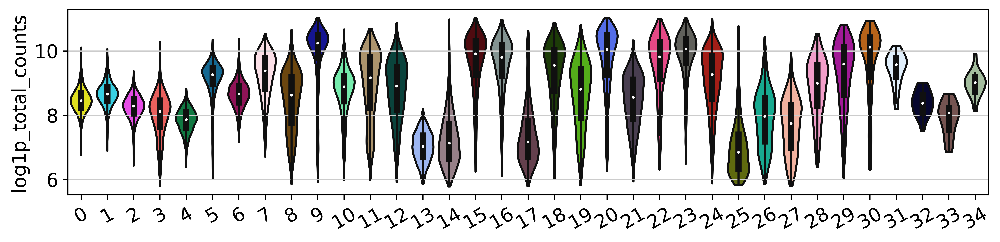

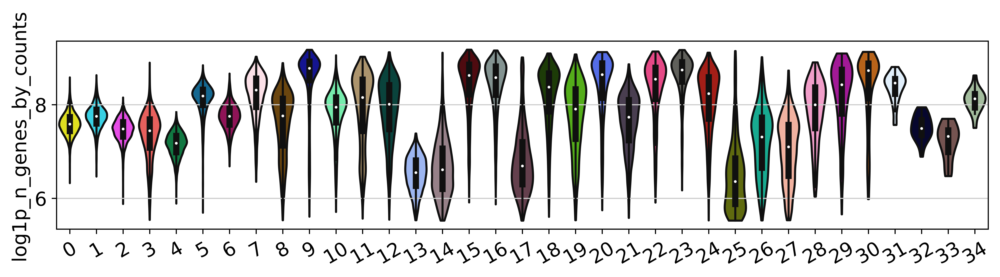

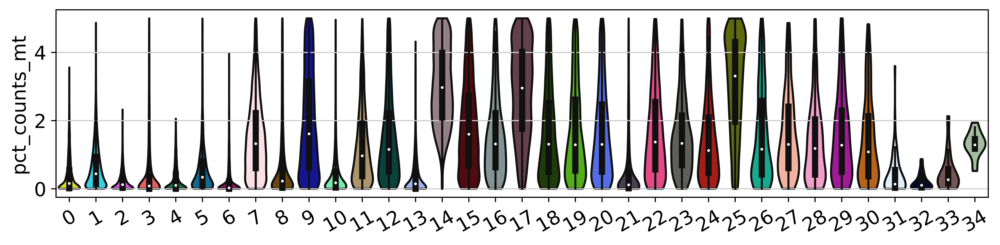

In [21]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)

In [22]:
adata.obs.leiden.value_counts()

0     8060
1     7056
2     5833
3     4775
4     4745
5     4462
6     4221
7     4214
8     4144
9     3561
10    3541
11    3509
12    2868
13    2854
14    2785
15    2780
16    2589
17    2436
18    2103
19    1734
20    1719
21    1578
22    1556
23    1137
24    1107
25    1101
26     785
27     675
28     438
29     428
30     423
31      59
32      46
33      31
34      15
Name: leiden, dtype: int64

## Annotate Clusters:

In [72]:
adata.obs = adata.obs.drop(['cell_type', 'annotation'], axis=1)

In [26]:

# load cluster anno df 
anno_df = pd.read_csv('{}/Zhou_leiden_clusters.csv'.format(data_dir))

anno_df.leiden = anno_df.leiden.astype(str)
temp = adata.obs.merge(
    anno_df, how='left',
    on = 'leiden')

adata.obs['cell_type'] = temp['cell_type'].astype(str).to_list()
adata.obs['annotation'] = temp['annotation'].astype(str).to_list()



In [27]:
# remove unknown & doublet clusters:
clusters_to_remove = ['Unknown', 'Doublet']
adata = adata[~adata.obs.annotation.isin(clusters_to_remove)]


In [28]:
# re-make umap 
sc.tl.umap(adata, min_dist=0.35, method='umap')

Trying to set attribute `.uns` of view, copying.


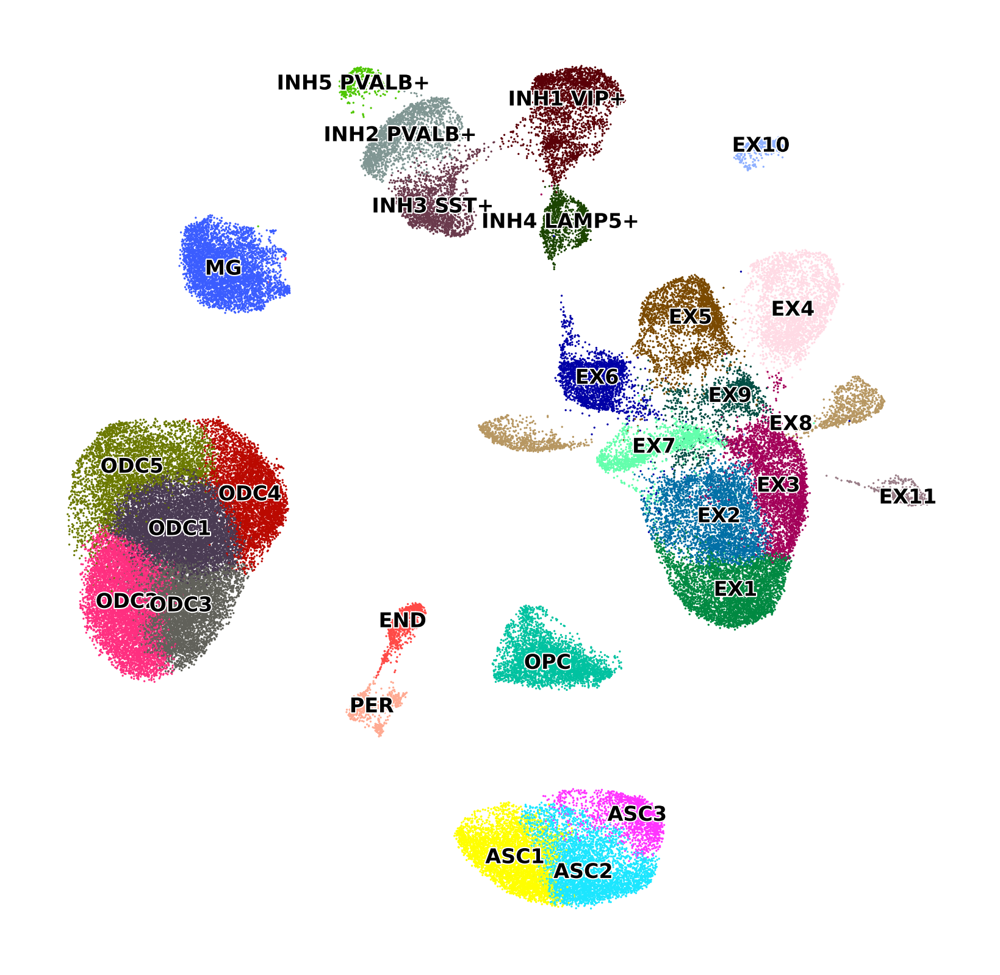

In [35]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=.75, 
    legend_fontsize=6, 
    title='',
    save='_annotation.pdf'
)


## Save processed dataset:

In [36]:
# write obs table 
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]
adata.obs.to_csv('{}/Zhou_2020_processed_obs.csv'.format(data_dir))

# write var table:
adata.var.to_csv('{}/Zhou_2020_processed_var.csv'.format(data_dir))

In [37]:
# write anndata:
adata.write_h5ad('{}/Zhou_2020_processed.h5ad'.format(data_dir))

In [38]:
# save the sparse matrix for Seurat:
X = adata.layers['counts']
X = scipy.sparse.csr_matrix.transpose(X)
io.mmwrite('{}/Zhou_2020_counts.mtx'.format(data_dir), X)

In [39]:
# save the Harmony Matrix for Seurat:
pd.DataFrame(adata.obsm['X_pca_harmony']).to_csv('{}/Zhou_2020_processed_harmony.csv'.format(data_dir))
